# Functions

In [1]:
import numpy as np
import matplotlib.pyplot as plt

import os
# %matplotlib inline
import logging
logging.getLogger().setLevel(logging.CRITICAL)

In [2]:
def ensure_dir(file_path):
    if not os.path.exists(file_path):
        os.makedirs(file_path)

# Main

In [3]:
figmap = [[np.nan, 7,15,23,31,39,47,np.nan],
          [     1, 8,16,24,32,40,48,    55],
          [     2, 9,17,25,33,41,49,    56],
          [     3,10,18,26,34,42,50,    57],
          [     4,11,19,27,35,43,51,    58],
          [     5,12,20,28,36,44,52,    59],
          [     6,13,21,29,37,45,53,    60],
          [np.nan,14,22,30,38,46,54,np.nan]]
figmap = np.array(figmap)

In [4]:
# exp_folder = 'D:\\GoogleDrive\\retina\\Chou\'s data\\20210701\\SplitData\\'
exp_folder = 'D:\\GoogleDrive\\retina\\Troy\'s data\\20211029\\SplitData\\'
# exp_folder = 'D:\\GoogleDrive\\retina\\Exps\\2021\\1028\\SplitData\\'
ensure_dir(exp_folder+'MI')
ensure_dir(exp_folder+'MI\\Fig')
ensure_dir(exp_folder+'MI\\Fig\\perSpike')

# DCCM

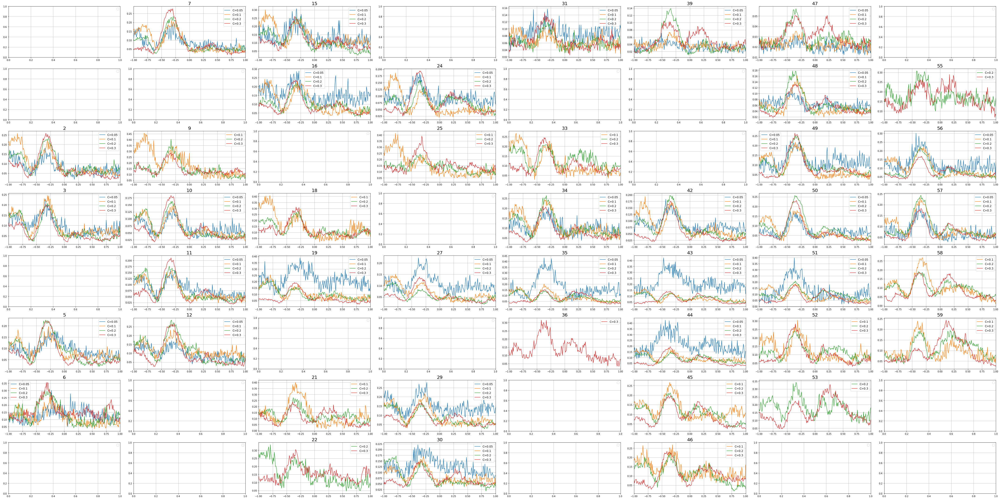

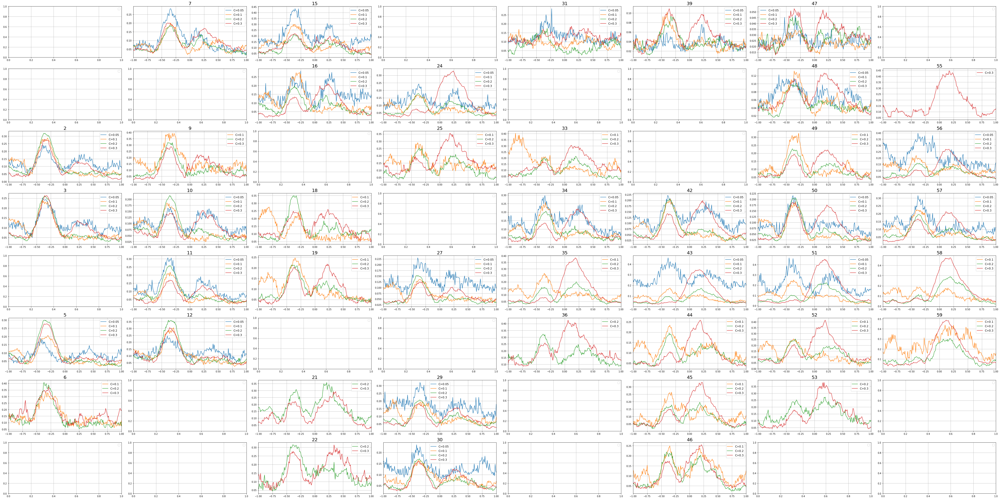

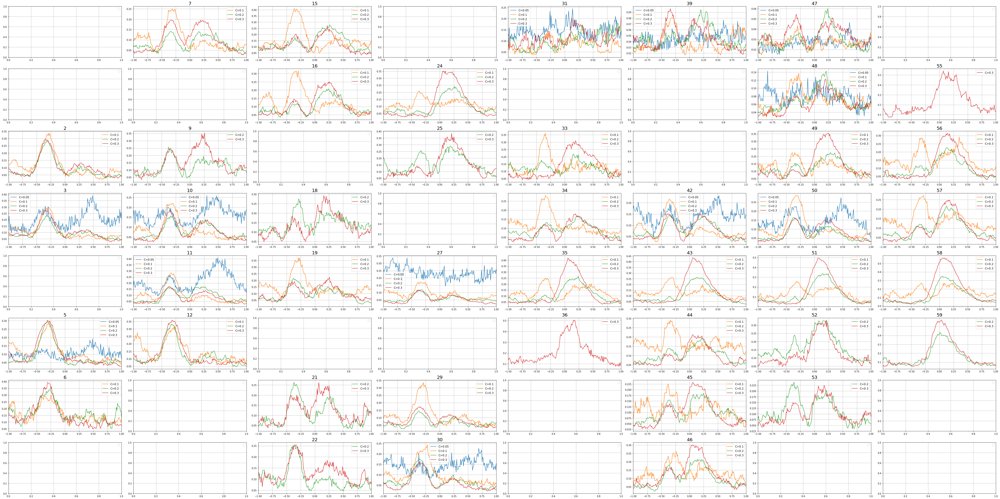

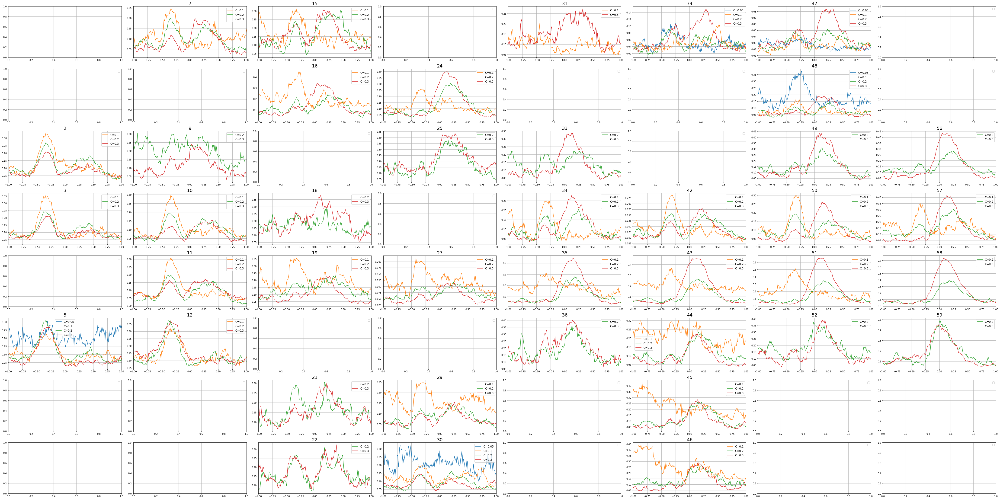

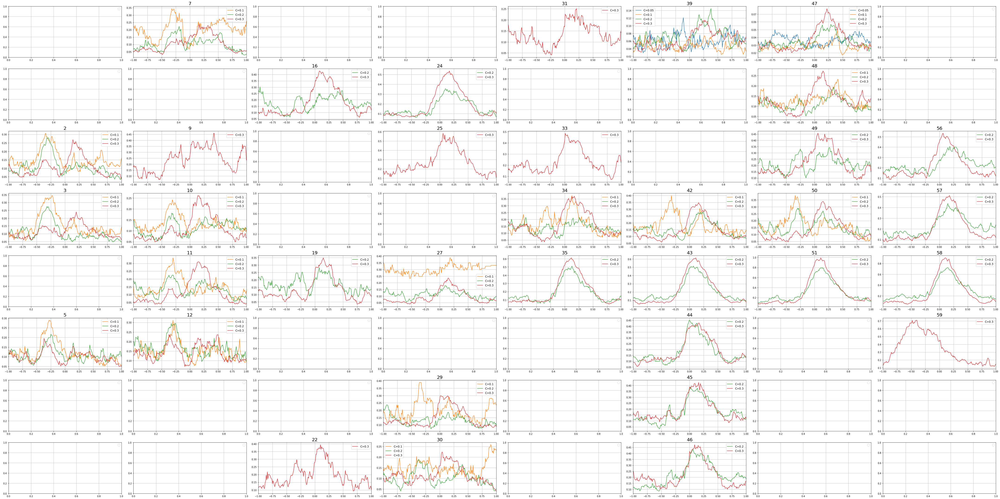

In [5]:
for Mean in [1,4,7,10,13]:
    MIdFcfig, MIdFcax = plt.subplots(nrows=8, ncols=8)
    cmind = 0
    for Contrast in [0.05,0.1,0.2,0.3]:
        filename = 'diode_OU_tau=500ms_cutoff=1_mean='+str(Mean)+'_C='+str(Contrast)+'_0'
        loadfiles = np.load(exp_folder+'MI\\MIperSpike_'+filename+'.npz', allow_pickle=True)
        for k in loadfiles.files:
            vars()[k] = loadfiles[k][()]

        for cn in range(60):
            Information = Information_cell[cn]
            try:
                MIdFcax[np.where(figmap == cn+1)][0].plot(timeshift,Information,  label='C='+str(Contrast), color = plt.cm.tab10(cmind))
                MIdFcax[np.where(figmap == cn+1)][0].set_xlim(timeshift[0],timeshift[-1])
                MIdFcax[np.where(figmap == cn+1)][0].set_title(str(cn+1), fontsize = 20)
            except:
                continue
    #         MIdFcax[np.where(figmap == cn+1)][0].set_xlabel(r'$\delta t$ (s)', fontsize = 16)
    #         MIdFcax[np.where(figmap == cn+1)][0].set_ylabel(r'Information (bit/s)', fontsize = 16)
        cmind += 1

    for ax1d in MIdFcax:
        for ax in ax1d:
            ax.legend(fontsize = 12)
            ax.grid()
    MIdFcfig.set_size_inches(60, 30)
    MIdFcfig.tight_layout()
    MIdFcfig.savefig(exp_folder+'MI\\Fig\\perSpike\\DCCM_WF_M='+str(Mean)+'_1Hz.tif', bbox_inches = 'tight',pad_inches = 0.3)

# CCDM

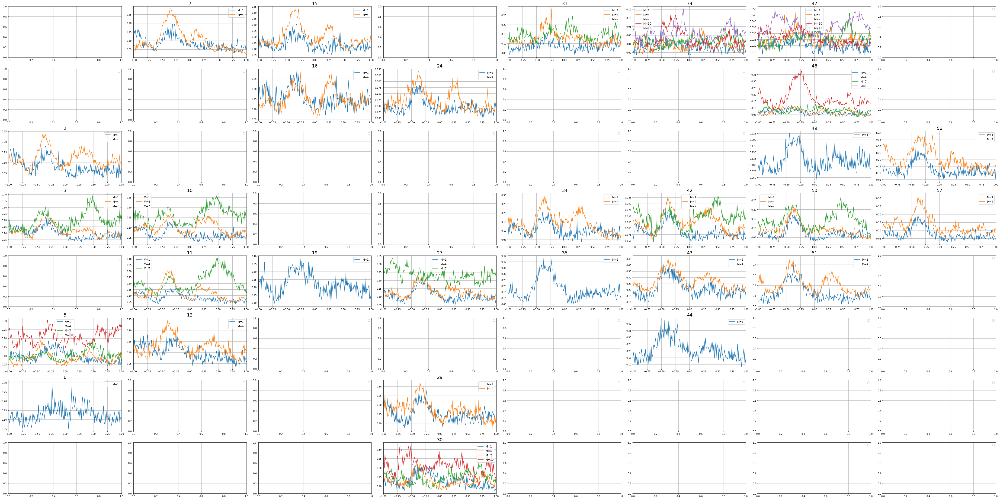

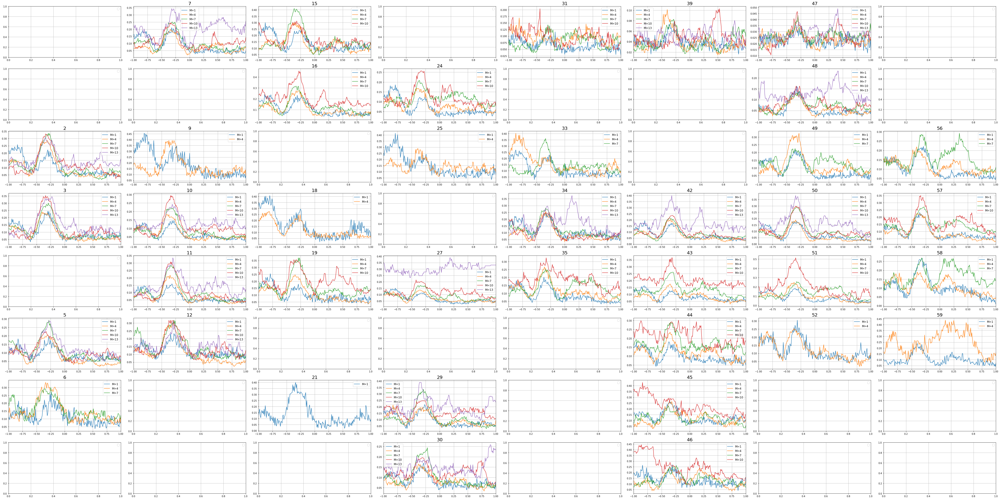

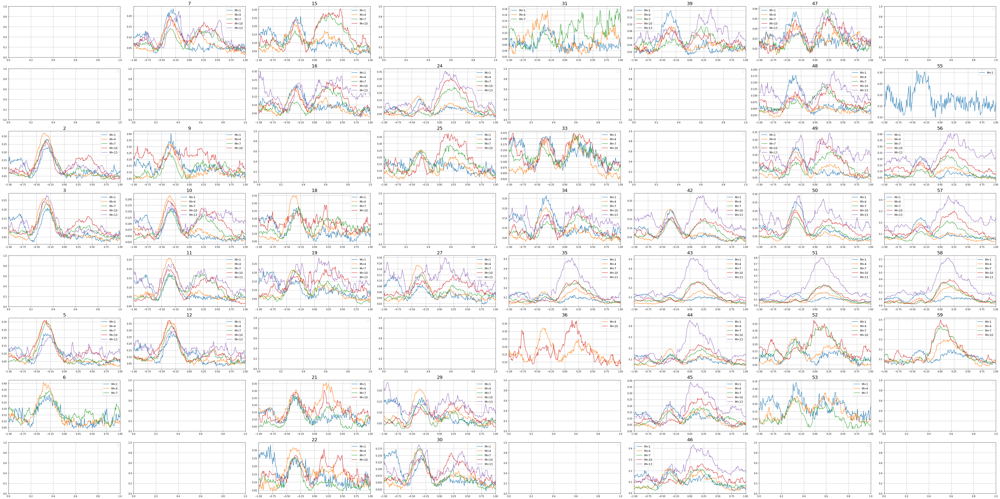

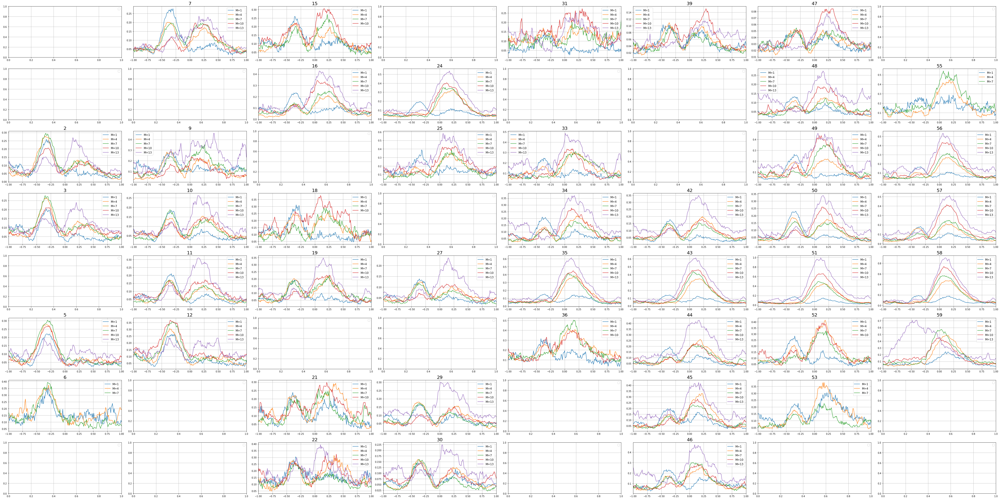

In [6]:

for Contrast in [0.05,0.1,0.2,0.3]:
    MIdFcfig, MIdFcax = plt.subplots(nrows=8, ncols=8)
    cmind = 0
    for Mean in [1,4,7,10,13]:
        filename = 'diode_OU_tau=500ms_cutoff=1_mean='+str(Mean)+'_C='+str(Contrast)+'_0'
        loadfiles = np.load(exp_folder+'MI\\MIperSpike_'+filename+'.npz', allow_pickle=True)
        for k in loadfiles.files:
            vars()[k] = loadfiles[k][()]

        for cn in range(60):
            Information = Information_cell[cn]
            try:
                MIdFcax[np.where(figmap == cn+1)][0].plot(timeshift,Information,  label='M='+str(Mean), color = plt.cm.tab10(cmind))
                MIdFcax[np.where(figmap == cn+1)][0].set_xlim(timeshift[0],timeshift[-1])
                MIdFcax[np.where(figmap == cn+1)][0].set_title(str(cn+1), fontsize = 20)
            except:
                continue
    #         MIdFcax[np.where(figmap == cn+1)][0].set_xlabel(r'$\delta t$ (s)', fontsize = 16)
    #         MIdFcax[np.where(figmap == cn+1)][0].set_ylabel(r'Information (bit/s)', fontsize = 16)
        cmind += 1

    for ax1d in MIdFcax:
        for ax in ax1d:
            ax.legend(fontsize = 12)
            ax.grid()
    MIdFcfig.set_size_inches(60, 30)
    MIdFcfig.tight_layout()
    MIdFcfig.savefig(exp_folder+'MI\\Fig\\perSpike\\CCDM_WF_C='+str(Contrast)+'_1Hz.tif', bbox_inches = 'tight',pad_inches = 0.3)